In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from collections import Counter
import time
#from scipy.spatial import cKDTree


In [2]:
class DataCloud:
    N = 0  # Contador global de nuvens de dados
    
    def __init__(self, x):
        #Inicializa uma nova nuvem de dados com o primeiro ponto x
        self.n = 1  # Número de pontos na nuvem
        self.mean = x  # Média (centroide)
        self.variance = 0  # Variância inicial (0 para um único ponto)
        self.pertinency = 1  # Grau de pertinência
        self.id = DataCloud.N  #NOVO: ID único e fixo para cada cloud
        DataCloud.N += 1  # Incrementa contador global

    def updateDataCloud(self , x):
        """Atualiza a nuvem com um novo ponto x usando as Eqs.recursivas 4 e 5 do artigo"""
        old_mean = self.mean
        old_variance = self.variance

        # Atualiza média (Eq. 4)
        self.mean = ((self.n - 1) * old_mean + x) / self.n

        # Atualiza variância (Eq. 5 corrigida, usando old_mean em vez da média já atualizada)
        self.variance = ((self.n - 1) / self.n) * old_variance + (1 / self.n) * np.linalg.norm(x - old_mean)**2

        self.n += 1  # Incrementa contador de pontos
        
        # Proteção contra variância zero após atualização
        self.variance = max(self.variance, 1e-3)


In [3]:
class AutoCloud():
    def __init__(self, m=2.4):  # Valor padrão (default) caso o usuário não especifique
        self.m = m  # Parâmetro de sensibilidade (Eq. 9)
        self.clouds = []  # Lista de DataClouds
        self.classIndex = []  # Histórico de classificações
        self.k = 0  # Contador de amostras processadas
        self.id_history = []     # guarda o ID original da cloud de cada amostra
        self.merge_log = []      # histórico de fusões: (k, id_i, id_j, id_resultante)
        self.sample_registry = {} # Dicionário para rastrear amostras processadas

    def calculate_eccentricity(self, x, cloud):
        """Calcula a excentricidade normalizada (Eqs. 3 e 12)"""
        if cloud.n == 0 or cloud.variance == 0:
            return 1.0  # Máxima excentricidade se não houver dados
    
        term1 = 1 / cloud.n
        diff = cloud.mean - x
        term2 = (diff.T @ diff) / (cloud.n * cloud.variance)
        
        return term1 + term2  # Sem divisão por 2!
    
    def merge_clouds(self, cloud_protegida=None):
        """Fusão de clouds baseada na sobreposição das amostras (Eqs. 16-20)"""
    
        epsilon = 1e-6  # Evita threshold = 0, se variância for zero(melhor opcao é 1e-6 nao mude! )

        merged_indices = set()  ##NOVO: guarda os índices das clouds que já foram fundidas neste instante
        '''
        i = 0
        while i < len(self.clouds):
            j = i + 1
            while j < len(self.clouds):
            '''
        i = 0
        while i < len(self.clouds):
            # Se o índice i já foi fundido antes, pula
            if i in merged_indices:
                i += 1
                continue

            j = i + 1
            while j < len(self.clouds):
                ##NOVO: se j ou i já foram fundidos antes, pula este par
                if j in merged_indices or i in merged_indices:
                    j += 1
                    continue

                # MUDANÇA 1: Calcular a distância entre médias UMA VEZ
                mean_i, mean_j = self.clouds[i].mean, self.clouds[j].mean
                mean_diff = np.linalg.norm(mean_i - mean_j)
                mean_diff_squared = mean_diff ** 2  # MUDANÇA 2: Armazenar o quadrado da distância

                # Proteção contra variância zero só na fusão
                var_i = self.clouds[i].variance + epsilon
                var_j = self.clouds[j].variance + epsilon
                threshold = self.m * (np.sqrt(var_i) + np.sqrt(var_j))

                # NOVO: proteção contra fusão imediata da cloud recém-criada
                # Pula se i ou j forem cloud_protegida
                
                if (self.clouds[i] is cloud_protegida or self.clouds[j] is cloud_protegida):
                    j += 1
                    continue
                
                if mean_diff < threshold:  # Usa Eq. 16 como critério de fusão

                    # NOVO BLOCO para o id — registrar a fusão:
                    id_i = self.clouds[i].id  # <<< ID fixo da cloud que permanecerá
                    id_j = self.clouds[j].id  # <<< ID fixo da cloud que será absorvida
                    self.merge_log.append((self.k, id_i, id_j, id_i))  # <<< Novo registro
                    
                    #print(f"[k={self.k}] Fusão: cloud ID {id_j} absorvida por cloud ID {id_i}") #lista ID

                    # Atualiza parâmetros da nova nuvem fundida (Eqs. 17-20)
                    ni, nj = self.clouds[i].n, self.clouds[j].n

                    # Atualiza do número de pontos após fusão
                    self.clouds[i].n = ni + nj

                    # Atualiza média (Eq. 18)
                    self.clouds[i].mean = (ni * mean_i + nj * mean_j) / (ni + nj)

                    # MUDANÇA 3: Usar mean_diff_squared no cálculo da nova variância
                    self.clouds[i].variance = (
                        (ni * var_i + nj * var_j + (ni * nj * mean_diff_squared) / (ni + nj)) / (ni + nj)
                    )

                    # Atualiza classIndex com realocação de índices
                    for k, idx in enumerate(self.classIndex):
                        if idx == j:
                            self.classIndex[k] = i
                        elif idx > j:
                            self.classIndex[k] -= 1
                    
                    print(f"Processadas {self.k} amostras, Fusão: cloud {j} absorvida por cloud {i}.") #classIndex

                    # Remove `cloud j`
                    self.clouds.pop(j)
                    print(f"[DEBUG:k={self.k}] Índices ativos após remoção: {[i for i in range(len(self.clouds))]}")#classIndex

                    ##MARCAR cloud j como fundida (nem precisa marcar i pois ele permanece, mas vamos marcar para segurança)
                    merged_indices.add(j)
                    
                    continue  # Mantém `i` fixo para reavaliar após fusão

                j += 1
            i += 1

    def calculate_quality(self):
        """Calcula a métrica de qualidade das fusões das clouds, baseada na Eq. 21 do artigo."""
        # Casos especiais
        if len(self.clouds) < 2:
            return 0.0

        total = 0.0
        min_distance = float('inf')
        eps = 1e-10  # Valor pequeno para evitar divisão por zero

        # Calcula a soma ponderada das variâncias
        for cloud in self.clouds:
            eccentricity = self.calculate_eccentricity(cloud.mean, cloud)
            typicality = max(0, 1 - (2 * eccentricity))  # Evita valores negativos
            total += (typicality**2) * (cloud.variance + eps)

        # Encontra a menor distância entre centróides de cloud distintos
        for i, c1 in enumerate(self.clouds):
            for j, c2 in enumerate(self.clouds):
                if i < j:
                    distance = np.linalg.norm(c1.mean - c2.mean)
                    if distance > eps:  
                        min_distance = min(min_distance, distance)

        # Se todos cloud forem muito próximos (possivelmente ruins)
        if min_distance == float('inf'):
            return 0.0

        # Cálculo final com proteção contra zero no denominador
        denominator = len(self.clouds) * max(min_distance, eps)
        return total / denominator

    def run(self, x):
        if self.k < 2000 or self.k % 5000 == 0:
            print(f"[k={self.k}] x = {x}")

        self.k += 1   #"estou processando mais uma amostra"
        x = np.array(x)  # Garante que x seja um numpy array

        # Passo 1: Primeira amostra → cria a primeira cloud
        if self.k == 1:
            self.clouds.append(DataCloud(x))
            self.classIndex.append(0)
            print(f"Processadas {self.k} amostras, cloud {len(self.clouds) - 1} criada.")
            return

        # Passo 2: Segunda amostra → sempre atualiza a primeira cloud
        if self.k == 2:
            self.clouds[0].updateDataCloud(x)
            self.classIndex.append(0)
            print(f"Processadas {self.k} amostras, pertence à cloud 0.")
            return

        # Passo 3: A partir da terceira amostra → checa tipicidade com excentricidade
        closest_cloud = None
        min_ecc = float('inf')
        threshold_factor = (self.m**2 + 1) / 2  # Cálculo movido para evitar redundância 

        for i, cloud in enumerate(self.clouds):
            ecc = self.calculate_eccentricity(x, cloud)
            threshold = threshold_factor / cloud.n  # Movido para dentro do loop para evitar cálculos repetidos
            
            if ecc <= threshold and ecc < min_ecc:
                closest_cloud = i
                min_ecc = ecc

        # Se a amostra for típica → atualiza cloud existente
        if closest_cloud is not None:
            #Isso substitui todo o bloco de atuallização da média/variância manual
            self.clouds[closest_cloud].updateDataCloud(x)
            self.classIndex.append(closest_cloud)
            print(f"Processadas {self.k} amostra, pertence à cloud {closest_cloud}.") #classIndex
            
            self.id_history.append(self.clouds[closest_cloud].id) # NOVO, para o id. Salva o ID fixo de cada amostra processada
            #print(f"[k={self.k}] Atribuída à cloud ID {self.clouds[closest_cloud].id}") #lista ID
            return  
        
        '''
        else:
            # Nenhuma cloud típica → cria nova cloud
            self.clouds.append(DataCloud(x))
            self.classIndex.append(len(self.clouds) - 1)
            print(f"Processadas {self.k} amostras, cloud {len(self.clouds) - 1} criada.")

            self.id_history.append(self.clouds[-1].id)  # NOVO, para o id.
            #print(f"[k={self.k}] Nova cloud criada com ID {self.clouds[-1].id}")

            # Fusão sob demanda (somente se nova cloud criada)
            self.merge_clouds()
        '''

        # Segunda verificação com distância do centróide
        # Passo 4: Verificação extra, distância euclidiana — pode não ser típica, mas está muito próxima?
        closest_cloud_euclid = None #Verifica dentre todas as clouds candidatas qual é a mais proxima da amostra k
        min_mean_diff = float('inf')
        
        for i, cloud in enumerate(self.clouds):
            mean_diff = np.linalg.norm(x - cloud.mean)
            threshold = self.m * (np.sqrt(cloud.variance + 1e-3))  # segurança contra var=0
        
            if mean_diff < threshold and mean_diff < min_mean_diff:
                closest_cloud_euclid = i
                min_mean_diff = mean_diff

        if closest_cloud_euclid is not None:
            self.clouds[closest_cloud_euclid].updateDataCloud(x)
            self.classIndex.append(closest_cloud_euclid)
            self.id_history.append(self.clouds[closest_cloud_euclid].id)
            print(f"Processadas {self.k} amostra, pertence à cloud {closest_cloud_euclid}.")#classIndex 
            #print(f"[k={self.k}] Atribuída à cloud ID {self.clouds[closest_cloud_euclid].id}")#lista ID

            return

            '''
            if mean_diff < threshold:
                self.clouds[i].updateDataCloud(x)
                self.classIndex.append(i)
                self.id_history.append(cloud.id)
                print(f"Processadas {self.k} amostra, pertence à cloud {i}.") #classIndex
                print(f"[k={self.k}] Atribuída à cloud ID {cloud.id}") #lista ID
                return
            '''
        # Passo 5: Nenhuma cloud típica ou próxima → cria nova cloud
        self.clouds.append(DataCloud(x))
        new_index = len(self.clouds) - 1
        self.classIndex.append(new_index)
        self.id_history.append(self.clouds[-1].id)
        print(f"Processadas {self.k} amostras, cloud {new_index} criada.") #classIndex 
        #print(f"[k={self.k}] Nova cloud criada com ID {self.clouds[-1].id}") #lista ID

        # Salvar referência da cloud recém-criada
        cloud_criada = self.clouds[-1] #classIndex

        # Fusão sob demanda
        #self.merge_clouds()

        # Fusão sob demanda com proteção
        self.merge_clouds(cloud_protegida=cloud_criada) #Para merge_clouds saber quando foi criada uma nova cloud.
        
        # Após fusão, verificar se a nova cloud mudou de índice usando classIndex
        if cloud_criada in self.clouds:
            updated_index = self.clouds.index(cloud_criada)
            if updated_index != new_index:
                print(f"Processadas {self.k} amostras, cloud {new_index} agora é cloud {updated_index} após fusões.") #classIndex
        

In [4]:
#Loop Loopinho
if __name__ == "__main__":
    import time

    # Criar e executar AutoCloud
    ac = AutoCloud(m=2.2)
    
    # Carregar dados
    df = pd.read_csv('dataset_entropia_legitimo_malicioso.csv', sep=',')

    features = df[['tcp.flags.ack','tcp.flags.syn','tcp.flags.fin']].values
    #features = df[['tcp.flags.ack','tcp.flags.syn','tcp.flags.fin','tcp.len','tcp.time_delta','mqtt.len']].values

    start_time = time.time()  # Inicia medição do tempo

    for i, x in enumerate(features[:402513]):  
        ac.run(x)

        if i % 1 == 0 and i > 0:  #Evita exibir na iteração 0
            elapsed = time.time() - start_time
            estimated_total = (elapsed / i) * 50000
            remaining_time = estimated_total - elapsed

            #print(f"Processadas {i} amostras, {len(ac.clouds)} clouds criadas")
            #print(f"Qualidade atual: {ac.calculate_quality():.4f}")
            #print(f"Tempo estimado restante: {remaining_time:.2f}s")  # Mostra tempo estimado


    # Testes adicionais
    print("\nTestes de consistência:")
    print(f"Total de amostras processadas: {len(ac.classIndex)}")
    print(f"Soma de amostras registradas nas clouds: {sum(cloud.n for cloud in ac.clouds)}")
    print(f"Frequência de clouds:\n{Counter(ac.classIndex)}")
    
    # Escolher as clouds mais populosas para análise
    cloud_counts = Counter(ac.classIndex)
    
    # Exibir estatísticas das clouds
    print("\nResultados finais:")
    print(f"Total de clouds: {len(ac.clouds)}")
    print(f"Métrica de qualidade: {ac.calculate_quality():.4f}")

    for i, cloud in enumerate(ac.clouds):
        num_amostras = cloud_counts.get(i, 0)
        print(f"\nCloud {i}:")
        print(f"  Núm. amostras: {cloud.n}")
        print(f"  Centróide: {cloud.mean}")
        print(f"  Variância: {cloud.variance:.4f}")
        print(f"  Amostras associadas: {num_amostras}")


[k=0] x = [0. 0. 0.]
Processadas 1 amostras, cloud 0 criada.
[k=1] x = [-1.44269516e-10  1.00000000e+00 -1.44269516e-10]
Processadas 2 amostras, pertence à cloud 0.
[k=2] x = [-1.44269516e-10  9.18295834e-01 -1.44269516e-10]
Processadas 3 amostra, pertence à cloud 0.
[k=3] x = [-1.44269516e-10  8.11278124e-01 -1.44269516e-10]
Processadas 4 amostra, pertence à cloud 0.
[k=4] x = [-1.44269516e-10  7.21928095e-01 -1.44269516e-10]
Processadas 5 amostra, pertence à cloud 0.
[k=5] x = [ 6.50022421e-01  9.18295834e-01 -1.44269516e-10]
Processadas 6 amostra, pertence à cloud 0.
[k=6] x = [ 8.63120568e-01  9.85228136e-01 -1.44269516e-10]
Processadas 7 amostra, pertence à cloud 0.
[k=7] x = [ 8.11278124e-01  1.00000000e+00 -1.44269516e-10]
Processadas 8 amostra, pertence à cloud 0.
[k=8] x = [ 7.64204506e-01  9.91076060e-01 -1.44269516e-10]
Processadas 9 amostra, pertence à cloud 0.
[k=9] x = [ 7.21928095e-01  9.70950594e-01 -1.44269516e-10]
Processadas 10 amostra, pertence à cloud 0.
[k=10] x =

In [5]:
print(len(ac.merge_log))

24


In [6]:
print(f"[DEBUG] Fusões registradas: {len(ac.merge_log)}")
if len(ac.merge_log) > 0:
    print("[DEBUG] Primeiras fusões registradas:")
    for fusao in ac.merge_log[:]:
        print(f"  k={fusao[0]}: Cloud {fusao[2]} + Cloud {fusao[1]} → Cloud {fusao[3]}")


[DEBUG] Fusões registradas: 24
[DEBUG] Primeiras fusões registradas:
  k=28330: Cloud 1 + Cloud 0 → Cloud 0
  k=37482: Cloud 2 + Cloud 0 → Cloud 0
  k=45552: Cloud 4 + Cloud 0 → Cloud 0
  k=46780: Cloud 5 + Cloud 3 → Cloud 3
  k=46904: Cloud 3 + Cloud 0 → Cloud 0
  k=47314: Cloud 6 + Cloud 0 → Cloud 0
  k=48506: Cloud 8 + Cloud 7 → Cloud 7
  k=49139: Cloud 7 + Cloud 0 → Cloud 0
  k=49139: Cloud 10 + Cloud 0 → Cloud 0
  k=116190: Cloud 11 + Cloud 0 → Cloud 0
  k=132491: Cloud 9 + Cloud 0 → Cloud 0
  k=134115: Cloud 12 + Cloud 0 → Cloud 0
  k=134390: Cloud 13 + Cloud 0 → Cloud 0
  k=136505: Cloud 14 + Cloud 0 → Cloud 0
  k=136663: Cloud 16 + Cloud 0 → Cloud 0
  k=137123: Cloud 17 + Cloud 0 → Cloud 0
  k=140604: Cloud 18 + Cloud 0 → Cloud 0
  k=140954: Cloud 19 + Cloud 0 → Cloud 0
  k=142620: Cloud 20 + Cloud 0 → Cloud 0
  k=145668: Cloud 21 + Cloud 0 → Cloud 0
  k=229669: Cloud 22 + Cloud 0 → Cloud 0
  k=230360: Cloud 23 + Cloud 15 → Cloud 15
  k=236297: Cloud 24 + Cloud 0 → Cloud 0
  k=

Grafico com multiplas paginas e com legendas em colunas 

In [7]:
"""
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from matplotlib.colors import TABLEAU_COLORS
from matplotlib.backends.backend_pdf import PdfPages  # ✧ PDF multipágina
import numpy as np
import pandas as pd
import os
from math import ceil  # ✧ Para quebrar legenda em partes

# ▶ Carrega os dados do CSV
dados = pd.read_csv('dataset_entropia_legitimo_malicioso.csv')

# ▶ Define os tamanhos das 3 partes distintas do dataset
tam_legitimo1 = 140544
tam_malicioso = 121425
tam_legitimo2 = 140544

# ▶ Separa as partes
dados1 = dados.iloc[:tam_legitimo1].copy()
dados2 = dados.iloc[tam_legitimo1:tam_legitimo1+tam_malicioso].copy()
dados3 = dados.iloc[tam_legitimo1+tam_malicioso:].copy()

# ▶ Cria eixo de tempo contínuo entre partes
dados1['tempo_continuo'] = dados1['frame.time_relative']
delta2 = dados2['frame.time_relative'].iloc[1] - dados2['frame.time_relative'].iloc[0]
offset2 = dados1['tempo_continuo'].iloc[-1] + delta2
dados2['tempo_continuo'] = dados2['frame.time_relative'] + offset2
delta3 = dados3['frame.time_relative'].iloc[1] - dados3['frame.time_relative'].iloc[0]
offset3 = dados2['tempo_continuo'].iloc[-1] + delta3
dados3['tempo_continuo'] = dados3['frame.time_relative'] + offset3

dados = pd.concat([dados1, dados2, dados3], ignore_index=True)

# ▶ Variáveis a serem analisadas
variaveis = ['tcp.flags.ack', 'tcp.flags.syn', 'tcp.flags.fin']
features = dados[variaveis].values
tempos = dados['tempo_continuo'].values
labels = dados['label'].values

# ▶ Tamanho do corte de visualização
j = 402513
features_plot = features[:j]
tempos_plot = tempos[:j]
labels_plot = labels[:j]
id_history_plot = ac.id_history[:j]  # ✧ Do AutoCloud
merge_log = ac.merge_log            # ✧ Registro de fusões
cores = list(TABLEAU_COLORS.values())

# ▶ Função: encontra intervalos de ataque
def encontrar_intervalos_ataque(tempos, labels):
    ataques = labels == 1.0
    indices = np.where(ataques)[0]
    if len(indices) == 0:
        return []
    intervalos = []
    inicio = indices[0]
    for i in range(1, len(indices)):
        if indices[i] != indices[i-1] + 1:
            fim = indices[i-1]
            intervalos.append((tempos[inicio], tempos[fim]))
            inicio = indices[i]
    intervalos.append((tempos[inicio], tempos[indices[-1]]))
    return intervalos

intervalos_ataque = encontrar_intervalos_ataque(tempos_plot, labels_plot)

# ▶ Cores para cada ID de cloud
ids_unicos = sorted(set(id_history_plot))
id_para_cor = {id_: cores[i % len(cores)] for i, id_ in enumerate(ids_unicos)}

# ▶ Apenas um grupo de 3 variáveis
grupos = [(0, 3, "Grupo 1: Variáveis 1–3")]
fim_parte1 = dados1['tempo_continuo'].iloc[-1]
fim_parte2 = dados2['tempo_continuo'].iloc[-1]

# ✧ Nome do arquivo com caminho para a Área de Trabalho
nome_arquivo = os.path.expanduser("~/Área de Trabalho/grafico_legenda_separada.pdf")

# ▶ Cria PDF multipágina
with PdfPages(nome_arquivo) as pdf:

    for inicio, fim_idx, titulo in grupos:
        num_vars = fim_idx - inicio
        fig, axs = plt.subplots(nrows=num_vars, ncols=1, figsize=(15, 2.5 * num_vars), sharex=True)
        fig.suptitle(titulo, fontsize=16)

        for idx, ax in enumerate(axs):
            var_idx = inicio + idx
            nome_variavel = variaveis[var_idx]
            dados_y = features_plot[:, var_idx]

            for id_cloud in ids_unicos:
                indices = np.where(np.array(id_history_plot) == id_cloud)[0]
                ax.plot(tempos_plot[indices], dados_y[indices], '.',
                        label=f"Cloud {id_cloud}",
                        color=id_para_cor[id_cloud], markersize=1)

            for start, end in intervalos_ataque:
                ax.axvspan(start, end, color='red', alpha=0.15)

            ax.axvline(fim_parte1, color='black', linestyle='--', linewidth=1)
            ax.axvline(fim_parte2, color='gray', linestyle='--', linewidth=1)

            ax.set_ylabel(nome_variavel)
            ax.grid(True)

        axs[-1].set_xlabel("Tempo contínuo (s)")

        plt.tight_layout(rect=[0, 0, 0.95, 0.96])
        pdf.savefig(fig)
        plt.close(fig)

    # ✧ Cria legenda distribuída em várias páginas e colunas
    def chunked(lst, n):
        for i in range(0, len(lst), n):
            yield lst[i:i + n]

    # ✧ Constrói handles
    handles = [Line2D([0], [0], marker='o', color='w',
                      label=f'Cloud {id_}',
                      markerfacecolor=id_para_cor[id_], markersize=6)
               for id_ in ids_unicos]

    for (k, id_i, id_j, id_result) in merge_log:
        handles.append(Line2D([0], [0], color='black',
                              label=f'Fusão: Cloud {id_j} + Cloud {id_i} = Cloud {id_result}',
                              markerfacecolor='none', linestyle='--'))

    handles += [
        Line2D([0], [0], color='black', linestyle='--', linewidth=1, label='Fim Parte 1'),
        Line2D([0], [0], color='gray', linestyle='--', linewidth=1, label='Fim Parte 2'),
    ]

    itens_por_pagina = 80  # ✧ Ajustável
    colunas = 2

    for grupo in chunked(handles, itens_por_pagina):
        fig_leg, ax_leg = plt.subplots(figsize=(15, 10))
        ax_leg.axis('off')
        ax_leg.legend(grupo,
                      [h.get_label() for h in grupo],
                      loc='upper left',
                      fontsize=10,
                      ncol=colunas,
                      borderaxespad=0.2,
                      handletextpad=1)
        pdf.savefig(fig_leg)
        plt.close(fig_leg)

# ✧ Permissão para leitura/cópia
os.chmod(nome_arquivo, 0o644)
"""

'\nimport matplotlib.pyplot as plt\nfrom matplotlib.lines import Line2D\nfrom matplotlib.colors import TABLEAU_COLORS\nfrom matplotlib.backends.backend_pdf import PdfPages  # ✧ PDF multipágina\nimport numpy as np\nimport pandas as pd\nimport os\nfrom math import ceil  # ✧ Para quebrar legenda em partes\n\n# ▶ Carrega os dados do CSV\ndados = pd.read_csv(\'dataset_entropia_legitimo_malicioso.csv\')\n\n# ▶ Define os tamanhos das 3 partes distintas do dataset\ntam_legitimo1 = 140544\ntam_malicioso = 121425\ntam_legitimo2 = 140544\n\n# ▶ Separa as partes\ndados1 = dados.iloc[:tam_legitimo1].copy()\ndados2 = dados.iloc[tam_legitimo1:tam_legitimo1+tam_malicioso].copy()\ndados3 = dados.iloc[tam_legitimo1+tam_malicioso:].copy()\n\n# ▶ Cria eixo de tempo contínuo entre partes\ndados1[\'tempo_continuo\'] = dados1[\'frame.time_relative\']\ndelta2 = dados2[\'frame.time_relative\'].iloc[1] - dados2[\'frame.time_relative\'].iloc[0]\noffset2 = dados1[\'tempo_continuo\'].iloc[-1] + delta2\ndados2[\'te

Grafico com duas paginas, uma o grafico e outra a legenda, so que a legenda esta incompleta.

FileNotFoundError: [Errno 2] No such file or directory: '/home/darc/Área de Trabalho/grafico_legenda_separada.pdf'

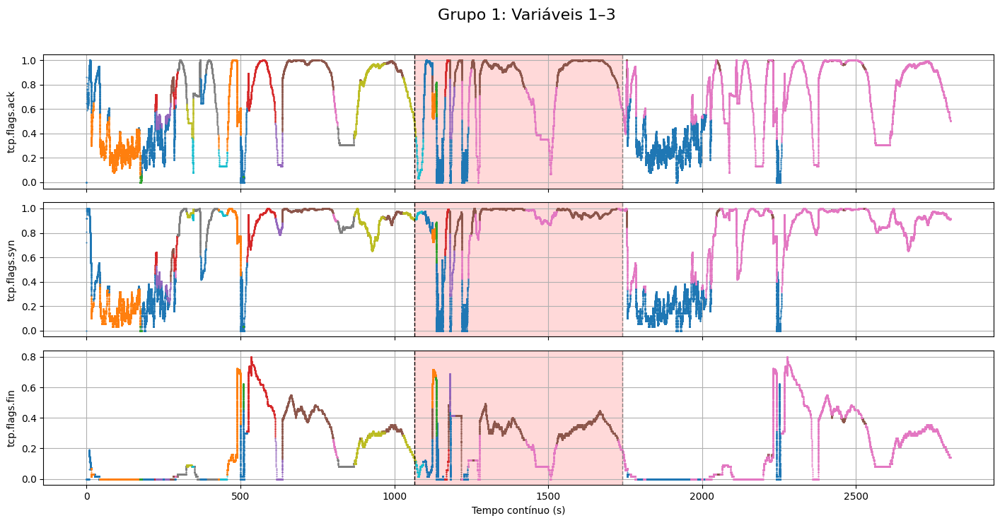

In [8]:

import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from matplotlib.colors import TABLEAU_COLORS
import numpy as np
import pandas as pd
import os
from matplotlib.backends.backend_pdf import PdfPages  #NOVO

# Dados já carregados
dados = pd.read_csv('dataset_entropia_legitimo_malicioso.csv')

# --- NOVO BLOCO: cria eixo de tempo contínuo ---
tam_legitimo1 = 140544
tam_malicioso = 121425
tam_legitimo2 = 140544

parte1 = dados.iloc[:tam_legitimo1].copy()
parte2 = dados.iloc[tam_legitimo1:tam_legitimo1+tam_malicioso].copy()
parte3 = dados.iloc[tam_legitimo1+tam_malicioso:].copy()

parte1['tempo_continuo'] = parte1['frame.time_relative']

delta2 = parte2['frame.time_relative'].iloc[1] - parte2['frame.time_relative'].iloc[0]
offset2 = parte1['tempo_continuo'].iloc[-1] + delta2
parte2['tempo_continuo'] = parte2['frame.time_relative'] + offset2

delta3 = parte3['frame.time_relative'].iloc[1] - parte3['frame.time_relative'].iloc[0]
offset3 = parte2['tempo_continuo'].iloc[-1] + delta3
parte3['tempo_continuo'] = parte3['frame.time_relative'] + offset3

dados = pd.concat([parte1, parte2, parte3], ignore_index=True)

# Dados do processamento
variaveis = ['tcp.flags.ack', 'tcp.flags.syn', 'tcp.flags.fin']
features = dados[variaveis].values
tempos = dados['tempo_continuo'].values
labels = dados['label'].values

j = 402513
features_plot = features[:j]
tempos_plot = tempos[:j]
labels_plot = labels[:j]
id_history_plot = ac.id_history[:j]
merge_log = ac.merge_log  # vem do AutoCloud
cores = list(TABLEAU_COLORS.values())

# Encontrar intervalos de ataque
def encontrar_intervalos_ataque(tempos, labels):
    ataques = labels == 1.0
    indices = np.where(ataques)[0]
    if len(indices) == 0:
        return []
    intervalos = []
    inicio = indices[0]
    for i in range(1, len(indices)):
        if indices[i] != indices[i-1] + 1:
            fim = indices[i-1]
            intervalos.append((tempos[inicio], tempos[fim]))
            inicio = indices[i]
    intervalos.append((tempos[inicio], tempos[indices[-1]]))
    return intervalos

intervalos_ataque = encontrar_intervalos_ataque(tempos_plot, labels_plot)

# Mapeia IDs para cores
ids_unicos = sorted(set(id_history_plot))
id_para_cor = {id_: cores[i % len(cores)] for i, id_ in enumerate(ids_unicos)}

# Grupos de variáveis
grupos = [(0, 3, "Grupo 1: Variáveis 1–3")]
fim_parte1 = parte1['tempo_continuo'].iloc[-1]
fim_parte2 = parte2['tempo_continuo'].iloc[-1]

#NOVO BLOCO DE PDF MULTIPÁGINA
#nome_arquivo = "grafico_legenda_separada.pdf"  # Conf. pode personalizar
nome_arquivo = os.path.expanduser("~/Área de Trabalho/grafico_legenda_separada.pdf")  # Para salva em outro lugar e ter as permissoes 
with PdfPages(nome_arquivo) as pdf:  # Conf. PDF com múltiplas páginas

    for inicio, fim_idx, titulo in grupos:
        num_vars = fim_idx - inicio
        fig, axs = plt.subplots(nrows=num_vars, ncols=1, figsize=(15, 2.5 * num_vars), sharex=True)
        fig.suptitle(titulo, fontsize=16)

        for idx, ax in enumerate(axs):
            var_idx = inicio + idx
            nome_variavel = variaveis[var_idx]
            dados_y = features_plot[:, var_idx]

            for id_cloud in ids_unicos:
                indices = np.where(np.array(id_history_plot) == id_cloud)[0]
                ax.plot(tempos_plot[indices], dados_y[indices], '.',
                        label=f"Cloud {id_cloud}",
                        color=id_para_cor[id_cloud], markersize=1)

            for start, end in intervalos_ataque:
                ax.axvspan(start, end, color='red', alpha=0.15)

            ax.axvline(fim_parte1, color='black', linestyle='--', linewidth=1)
            ax.axvline(fim_parte2, color='gray', linestyle='--', linewidth=1)

            ax.set_ylabel(nome_variavel)
            ax.grid(True)

        axs[-1].set_xlabel("Tempo contínuo (s)")

        plt.tight_layout(rect=[0, 0, 0.95, 0.96])
        pdf.savefig(fig)  # Conf. Salva a 1ª página com o gráfico
        plt.close(fig)    # Conf. Libera memória

    # 🔧 NOVO: Segunda página só com a legenda
    fig_leg, ax_leg = plt.subplots(figsize=(15, 10))  # Tamanho padrão
    ax_leg.axis('off')

    handles = [Line2D([0], [0], marker='o', color='w',
                      label=f'Cloud {id_}',
                      markerfacecolor=id_para_cor[id_], markersize=6)
               for id_ in ids_unicos]

    for (k, id_i, id_j, id_result) in merge_log:
        handles.append(Line2D([0], [0], color='w',
                              label=f'Fusão: Cloud {id_j} + Cloud {id_i} = Cloud {id_result}',
                              markerfacecolor='none', linestyle='--'))

    handles += [
        Line2D([0], [0], color='black', linestyle='--', linewidth=1, label='Fim Parte 1'),
        Line2D([0], [0], color='gray', linestyle='--', linewidth=1, label='Fim Parte 2'),
    ]

    ax_leg.legend(handles=handles, loc='upper left', fontsize=10)  # Conf. Legenda ocupando a nova página
    pdf.savefig(fig_leg)  # Conf. Salva a 2ª página com a legenda
    plt.close(fig_leg)

# 🔧 Permissão de leitura/cópia
os.chmod(nome_arquivo, 0o644)




grafico com plot show e cores unicas para cada cloud criada 

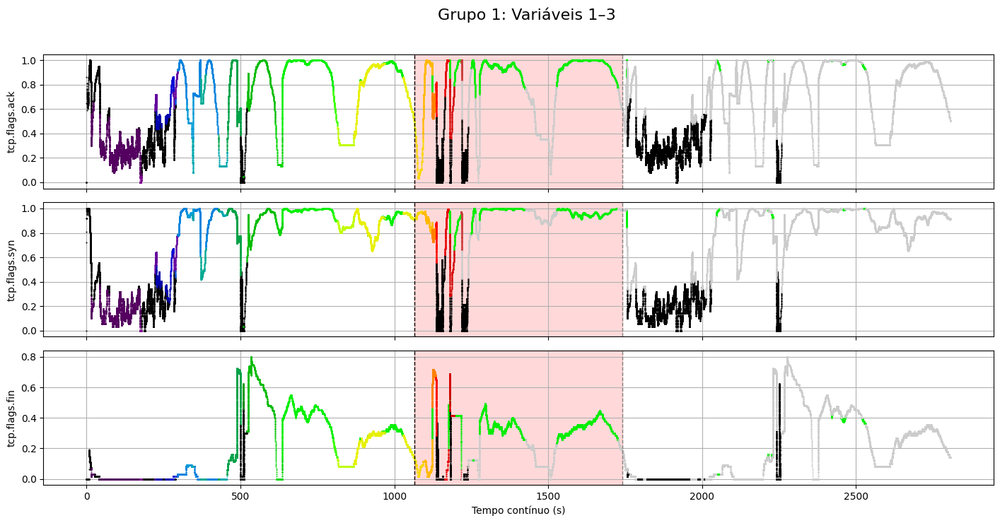

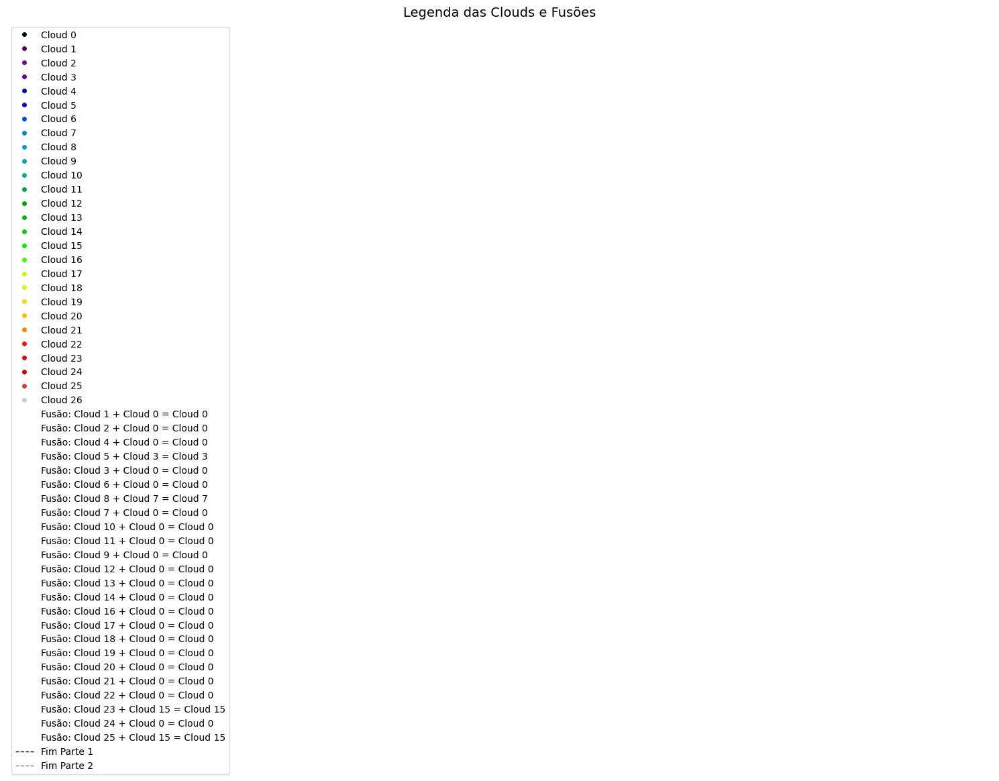

In [10]:
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from matplotlib.colors import TABLEAU_COLORS
import numpy as np
import pandas as pd
import os
from matplotlib.backends.backend_pdf import PdfPages  #NOVO
from matplotlib import cm  # já está importado, mas garantimos

# Dados já carregados
dados = pd.read_csv('dataset_entropia_legitimo_malicioso.csv')

# --- NOVO BLOCO: cria eixo de tempo contínuo ---
tam_legitimo1 = 140544
tam_malicioso = 121425
tam_legitimo2 = 140544

parte1 = dados.iloc[:tam_legitimo1].copy()
parte2 = dados.iloc[tam_legitimo1:tam_legitimo1+tam_malicioso].copy()
parte3 = dados.iloc[tam_legitimo1+tam_malicioso:].copy()

parte1['tempo_continuo'] = parte1['frame.time_relative']

delta2 = parte2['frame.time_relative'].iloc[1] - parte2['frame.time_relative'].iloc[0]
offset2 = parte1['tempo_continuo'].iloc[-1] + delta2
parte2['tempo_continuo'] = parte2['frame.time_relative'] + offset2

delta3 = parte3['frame.time_relative'].iloc[1] - parte3['frame.time_relative'].iloc[0]
offset3 = parte2['tempo_continuo'].iloc[-1] + delta3
parte3['tempo_continuo'] = parte3['frame.time_relative'] + offset3

dados = pd.concat([parte1, parte2, parte3], ignore_index=True)

# Dados do processamento
variaveis = ['tcp.flags.ack', 'tcp.flags.syn', 'tcp.flags.fin']
features = dados[variaveis].values
tempos = dados['tempo_continuo'].values
labels = dados['label'].values

j = 402513
features_plot = features[:j]
tempos_plot = tempos[:j]
labels_plot = labels[:j]
id_history_plot = ac.id_history[:j]
merge_log = ac.merge_log  # vem do AutoCloud
#cores = list(TABLEAU_COLORS.values())  #Ate 10 cores 

# Gerar mapa de cores com número exato de IDs únicos
ids_unicos = sorted(set(id_history_plot))
cmap = plt.colormaps.get_cmap('nipy_spectral')  # nova forma correta
id_para_cor = {
    id_: cmap(i / max(1, len(ids_unicos) - 1)) for i, id_ in enumerate(ids_unicos)
}

# Encontrar intervalos de ataque
def encontrar_intervalos_ataque(tempos, labels):
    ataques = labels == 1.0
    indices = np.where(ataques)[0]
    if len(indices) == 0:
        return []
    intervalos = []
    inicio = indices[0]
    for i in range(1, len(indices)):
        if indices[i] != indices[i-1] + 1:
            fim = indices[i-1]
            intervalos.append((tempos[inicio], tempos[fim]))
            inicio = indices[i]
    intervalos.append((tempos[inicio], tempos[indices[-1]]))
    return intervalos

intervalos_ataque = encontrar_intervalos_ataque(tempos_plot, labels_plot)

# Mapeia IDs para cores
#ids_unicos = sorted(set(id_history_plot))
#id_para_cor = {id_: cores[i % len(cores)] for i, id_ in enumerate(ids_unicos)}

# Grupos de variáveis
grupos = [(0, 3, "Grupo 1: Variáveis 1–3")]
fim_parte1 = parte1['tempo_continuo'].iloc[-1]
fim_parte2 = parte2['tempo_continuo'].iloc[-1]

for inicio, fim_idx, titulo in grupos:
    num_vars = fim_idx - inicio
    fig, axs = plt.subplots(nrows=num_vars, ncols=1, figsize=(15, 2.5 * num_vars), sharex=True)
    fig.suptitle(titulo, fontsize=16)

    for idx, ax in enumerate(axs):
        var_idx = inicio + idx
        nome_variavel = variaveis[var_idx]
        dados_y = features_plot[:, var_idx]

        for id_cloud in ids_unicos:
            indices = np.where(np.array(id_history_plot) == id_cloud)[0]
            ax.plot(tempos_plot[indices], dados_y[indices], '.',
                    label=f"Cloud {id_cloud}",
                    color=id_para_cor[id_cloud], markersize=1)

        for start, end in intervalos_ataque:
            ax.axvspan(start, end, color='red', alpha=0.15)

        ax.axvline(fim_parte1, color='black', linestyle='--', linewidth=1)
        ax.axvline(fim_parte2, color='gray', linestyle='--', linewidth=1)

        ax.set_ylabel(nome_variavel)
        ax.grid(True)

    axs[-1].set_xlabel("Tempo contínuo (s)")
    plt.tight_layout(rect=[0, 0, 0.95, 0.96])
    plt.show()  #NOVO: Exibe o gráfico com as séries

#NOVO BLOCO: Legenda em uma nova janela
fig_leg, ax_leg = plt.subplots(figsize=(15, 10))
ax_leg.axis('off')

handles = [Line2D([0], [0], marker='o', color='w',
                  label=f'Cloud {id_}',
                  markerfacecolor=id_para_cor[id_], markersize=6)
           for id_ in ids_unicos]

for (k, id_i, id_j, id_result) in merge_log:
    handles.append(Line2D([0], [0], color='w',
                          label=f'Fusão: Cloud {id_j} + Cloud {id_i} = Cloud {id_result}',
                          markerfacecolor='none', linestyle='--'))

handles += [
    Line2D([0], [0], color='black', linestyle='--', linewidth=1, label='Fim Parte 1'),
    Line2D([0], [0], color='gray', linestyle='--', linewidth=1, label='Fim Parte 2'),
]

ax_leg.legend(handles=handles, loc='upper left', fontsize=10)
plt.title("Legenda das Clouds e Fusões", fontsize=14)
plt.tight_layout()
plt.show()  # NOVO: Mostra a "segunda página" com a legenda


In [ ]:
""""
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from matplotlib.colors import TABLEAU_COLORS
import numpy as np
import pandas as pd
import os

# Dados já carregados
dados = pd.read_csv('dataset_entropia_legitimo_malicioso.csv')

# --- NOVO BLOCO: cria eixo de tempo contínuo ---
tam_legitimo1 = 140544
tam_malicioso = 121425
tam_legitimo2 = 140544

parte1 = dados.iloc[:tam_legitimo1].copy()
parte2 = dados.iloc[tam_legitimo1:tam_legitimo1+tam_malicioso].copy()
parte3 = dados.iloc[tam_legitimo1+tam_malicioso:].copy()

parte1['tempo_continuo'] = parte1['frame.time_relative']

delta2 = parte2['frame.time_relative'].iloc[1] - parte2['frame.time_relative'].iloc[0]
offset2 = parte1['tempo_continuo'].iloc[-1] + delta2
parte2['tempo_continuo'] = parte2['frame.time_relative'] + offset2

delta3 = parte3['frame.time_relative'].iloc[1] - parte3['frame.time_relative'].iloc[0]
offset3 = parte2['tempo_continuo'].iloc[-1] + delta3
parte3['tempo_continuo'] = parte3['frame.time_relative'] + offset3

dados = pd.concat([parte1, parte2, parte3], ignore_index=True)

# Dados do processamento
variaveis = ['tcp.flags.ack', 'tcp.flags.syn', 'tcp.flags.fin']
features = dados[variaveis].values
tempos = dados['tempo_continuo'].values
labels = dados['label'].values

j = 402513
#j = 261969
features_plot = features[:j]
tempos_plot = tempos[:j]
labels_plot = labels[:j]
id_history_plot = ac.id_history[:j]
merge_log = ac.merge_log  # vem do AutoCloud
cores = list(TABLEAU_COLORS.values())

# Encontrar intervalos de ataque
def encontrar_intervalos_ataque(tempos, labels):
    ataques = labels == 1.0
    indices = np.where(ataques)[0]
    if len(indices) == 0:
        return []
    intervalos = []
    inicio = indices[0]
    for i in range(1, len(indices)):
        if indices[i] != indices[i-1] + 1:
            fim = indices[i-1]
            intervalos.append((tempos[inicio], tempos[fim]))
            inicio = indices[i]
    intervalos.append((tempos[inicio], tempos[indices[-1]]))
    return intervalos

intervalos_ataque = encontrar_intervalos_ataque(tempos_plot, labels_plot)

# Mapeia IDs para cores
ids_unicos = sorted(set(id_history_plot))
id_para_cor = {id_: cores[i % len(cores)] for i, id_ in enumerate(ids_unicos)}

# Grupos de variáveis
grupos = [(0, 3, "Grupo 1: Variáveis 1–3")]
fim_parte1 = parte1['tempo_continuo'].iloc[-1]
fim_parte2 = parte2['tempo_continuo'].iloc[-1]

#for inicio, fim, titulo in grupos:
    #fig, axs = plt.subplots(nrows=fim - inicio, ncols=1, figsize=(15, 2.5 * (fim - inicio)), sharex=True)
for inicio, fim_idx, titulo in grupos:
    num_vars = fim_idx - inicio
    fig, axs = plt.subplots(nrows=num_vars, ncols=1, figsize=(15, 2.5 * num_vars), sharex=True)
    fig.suptitle(titulo, fontsize=16)

    for idx, ax in enumerate(axs):
        var_idx = inicio + idx
        nome_variavel = variaveis[var_idx]
        dados_y = features_plot[:, var_idx]

        for id_cloud in ids_unicos:
            indices = np.where(np.array(id_history_plot) == id_cloud)[0]
            ax.plot(tempos_plot[indices], dados_y[indices], '.',
                    label=f"Cloud {id_cloud}",
                    color=id_para_cor[id_cloud], markersize=1)

        for start, end in intervalos_ataque:
            ax.axvspan(start, end, color='red', alpha=0.15)

        ax.axvline(fim_parte1, color='black', linestyle='--', linewidth=1)
        ax.axvline(fim_parte2, color='gray', linestyle='--', linewidth=1)

        ax.set_ylabel(nome_variavel)
        ax.grid(True)

    axs[-1].set_xlabel("Tempo contínuo (s)")

    # Legenda
    handles = [Line2D([0], [0], marker='o', color='w',
                      label=f'Cloud {id_}',
                      markerfacecolor=id_para_cor[id_], markersize=6)
               for id_ in ids_unicos]

    # Fusão na legenda
    for (k, id_i, id_j, id_result) in merge_log:
        handles.append(Line2D([0], [0], color='w',
                              label=f'Fusão: Cloud {id_j} + Cloud {id_i} = Cloud {id_result}',
                              markerfacecolor='none', linestyle='--'))

    handles += [
        Line2D([0], [0], color='black', linestyle='--', linewidth=1, label='Fim Parte 1'),
        Line2D([0], [0], color='gray', linestyle='--', linewidth=1, label='Fim Parte 2'),
    ]

    fig.legend(handles=handles, loc='upper right', bbox_to_anchor=(1.15, 0.98))
    plt.tight_layout(rect=[0, 0, 0.95, 0.96])
    #plt.show()

    nome_arquivo = titulo.lower().replace(" ", "_").replace(":", "") + ".pdf"
    plt.savefig(nome_arquivo, format="pdf", dpi=300, bbox_inches="tight")

    # NOVO: Garante que o PDF tenha permissão de leitura e escrita
    os.chmod(nome_arquivo, 0o644)  # rw-r--r--

    plt.close(fig)  # Fecha a figura para liberar memória


    '''
    nome_arquivo = titulo.lower().replace(" ", "_").replace(":", "") + ".pdf"
    plt.savefig(nome_arquivo, format="pdf", dpi=300, bbox_inches="tight")
    plt.close(fig)  # Fecha a figura para liberar memória
    '''
"""